# Taller de boosting

## Se pide : 
        * Identificar el tipo de vino en los valores faltantes
        * Estimar el precio

In [81]:
import pandas as pd
import plotly.express as px
import numpy as np 
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
from ipywidgets import widgets
from IPython.display import display
from plotly.subplots import make_subplots
from scipy.stats import chi2_contingency

pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

In [66]:
wines=pd.read_csv('../maria_vinos.csv')
wines_less=pd.read_csv('../maria_sintipo_sinprecio.csv')

# EDA (Análisis exploratorio de datos)

## Compresión del Data set

### Descrición de variables
        * vignedo: Nombre de la viña o viñedo que produce el vino. Nominal - Feature 
        * vino: Indica el nombre del vino producido por el viñedo. Nominal - Feature
        * agno Indica la añada (año) de producción del vino. Discreta - Feture
        * rating: Indica el rating dado por los consumidores del vino en la aplicación Vivino.  Continua - Feature
        * nro_revis: Indica el número de revisiones que ha tenido el vino desde su inclusión en la aplicación.  Discreta - Feature
        * país: País de origen del vignedo donde se produce el vino.  Nominal - Feature
        * region Indica la región o valle donde se produce este vino. Nominal - Feature  
        * precio: El precio en euros que se vende internacionalmente este vino.  Continua - Target
        * tipo Indica que variedad de vino es.  Nominal - Target
        * cuerpo: Puntuación del cuerpo, definida como la riqueza y peso del vino en la boca [de 1 a 5].   Nominal - Feature
        * acidez: Puntuación de acidez, definida como el punto “más alto” del vino o su tartáridez; es lo que  hace que un vino sea refrescante y que tu lengua salive y quieras otro sorbo [de 1 a 5]. Nominal - Feature

In [67]:
wines.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1650 entries, 0 to 1649
Data columns (total 11 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   vignedo   1650 non-null   object 
 1   vino      1650 non-null   object 
 2   agno      1650 non-null   int64  
 3   rating    1650 non-null   float64
 4   nro_revs  1650 non-null   int64  
 5   pais      1650 non-null   object 
 6   region    1650 non-null   object 
 7   precio    1650 non-null   float64
 8   tipo      1617 non-null   object 
 9   cuerpo    1650 non-null   int64  
 10  acidez    1650 non-null   int64  
dtypes: float64(2), int64(4), object(5)
memory usage: 141.9+ KB


### Identificar valores faltantes y estrategia 

En este caso los valores faltantes solo están en la variable categórica tipo con un porcentaje del 2% de valores faltantes

Con respecto a la estrategía sobre los valores faltantes es una decisión que se tomará luego de tener una visualización más general de los datos

In [68]:
missing_values = wines.isnull().sum()

fig_missing = px.bar(
    x=missing_values.index, 
    y=missing_values.values, 
    labels={'y':'Cantidad de Valores Faltantes', 'x':'Variable'},
    title='Valores Faltantes por Variable'
)

fig_missing.show()

In [69]:
# cols_cat = wines[['vignedo','vino','agno','region','tipo']]
# for columna in cols_cat:
#         plt.figure(figsize=(10, 6))
#         plt.bar(cols_cat.index, cols_cat[columna])
#         plt.xlabel('Índice')  
#         plt.ylabel(columna)
#         plt.title(f'Gráfico de barras para {columna}')
#         plt.show()

## Estadística descriptiva

Se presentan las descripciones básicas de las variables cuantitativas

In [70]:
wines[['agno','rating','nro_revs','precio','cuerpo','acidez']].describe()

,agno,rating,nro_revs,precio,cuerpo,acidez
count,1650.000000,1650.000000,1650.000000,1650.000000,1650.000000,1650.00000
mean,2010.880000,4.410242,551.463636,143.482727,3.996364,2.74303
std,11.584798,0.147543,1180.883993,275.477234,1.223377,0.77524
min,1910.000000,4.200000,25.000000,6.300000,0.000000,0.00000
25%,2010.000000,4.300000,56.000000,33.000000,4.000000,3.00000
50%,2015.000000,4.400000,136.000000,56.300000,4.000000,3.00000
75%,2017.000000,4.500000,499.750000,121.725000,5.000000,3.00000
max,2021.000000,4.900000,16505.000000,3119.100000,5.000000,3.00000


Frecuencia de categrías para las variables cualitativas

In [71]:

columnas_de_interes = wines[['vignedo','vino','pais','region','tipo']].columns.values
subset_wines = wines[columnas_de_interes]

for columna in subset_wines.columns:
    valores_unicos = subset_wines[columna].unique()
    frecuencia = subset_wines[columna].value_counts()
    print("\nFrecuencia:",frecuencia)
    print("\n" + "="*30 + "\n")


Frecuencia: vignedo
Vega Sicilia                                        85
Alvaro Palacios                                     40
Artadi                                              38
Marques de Murrieta                                 31
Martinet                                            30
La Rioja Alta                                       28
Dominio de Pingus                                   27
Vina Sastre                                         25
Abadia Retuerta                                     22
Toro Albala                                         21
Emilio Moro                                         21
Clos Mogador                                        19
Remirez de Ganuza                                   19
Bodegas Roda                                        18
Marques de Riscal                                   18
Familia Torres                                      17
Bodega Contador (Benjamin Romeo)                    17
Teso La Monja                               

## Visualización de Datos

Gráfico para variables categóricas

In [72]:
frecuencia = wines['tipo'].value_counts()

# Crea un DataFrame con los nombres y las frecuencias
df_frecuencia = pd.DataFrame({'Tipo': frecuencia.index, 'Frecuencia': frecuencia.values})

# Ajusta el tamaño del gráfico
altura_grafico = max(10, len(df_frecuencia) * 0.5)  # Ajusta según el número de tipos

# Crea el gráfico de barras
fig = go.Figure()
fig.add_trace(go.Bar(x=df_frecuencia['Tipo'], y=df_frecuencia['Frecuencia'], text=df_frecuencia['Frecuencia']))

# Añade scroll bar
fig.update_xaxes(tickangle=45, tickmode='linear', tick0=0, dtick=1)

# Ajusta el tamaño del gráfico
fig.update_layout(title_text='Frecuencia de Tipos de Vino', height=altura_grafico * 50)

# Muestra el gráfico en el notebook
fig.show()

In [73]:
result_df = pd.DataFrame()

for column in wines[['vignedo', 'vino', 'pais', 'region', 'tipo']].columns.values:
    # Obtener valores únicos y sus frecuencias
    value_counts = wines[column].value_counts()
    
    # Crear un DataFrame temporal con los resultados
    temp_df = pd.DataFrame({
        'Columna': [column] * len(value_counts),
        'Valor': value_counts.index,
        'Frecuencia': value_counts.values
    })
    
    # Agregar los resultados al DataFrame principal
    result_df = pd.concat([result_df, temp_df], ignore_index=True)

# Imprimir el DataFrame final
print(result_df)

      Columna                                              Valor  Frecuencia
0     vignedo                                       Vega Sicilia          85
1     vignedo                                    Alvaro Palacios          40
2     vignedo                                             Artadi          38
3     vignedo                                Marques de Murrieta          31
4     vignedo                                           Martinet          30
5     vignedo                                      La Rioja Alta          28
6     vignedo                                  Dominio de Pingus          27
7     vignedo                                        Vina Sastre          25
8     vignedo                                    Abadia Retuerta          22
9     vignedo                                        Toro Albala          21
10    vignedo                                        Emilio Moro          21
11    vignedo                                       Clos Mogador          19

Gráficos para variables cuantitativas

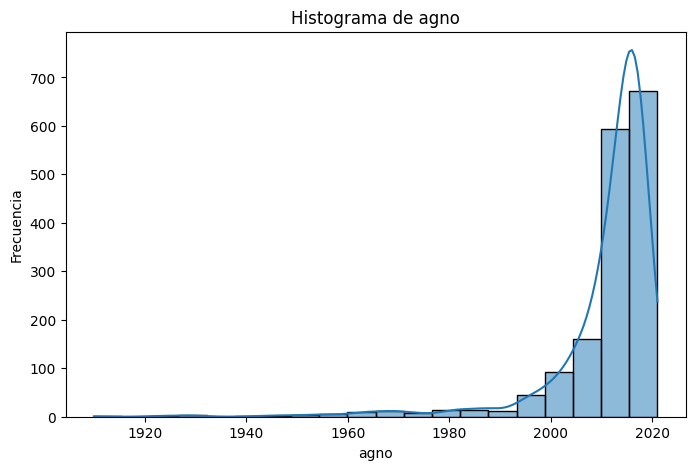

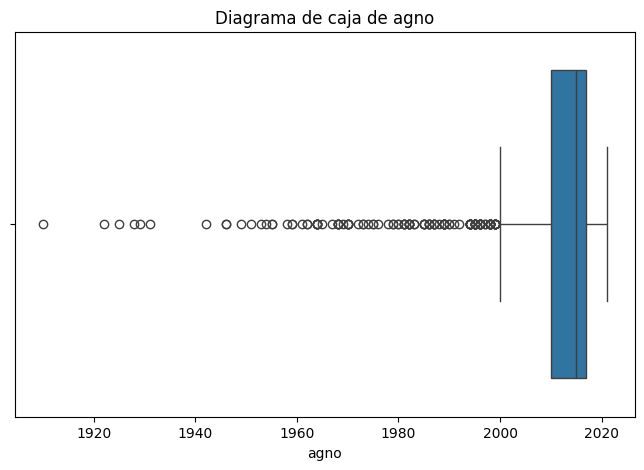

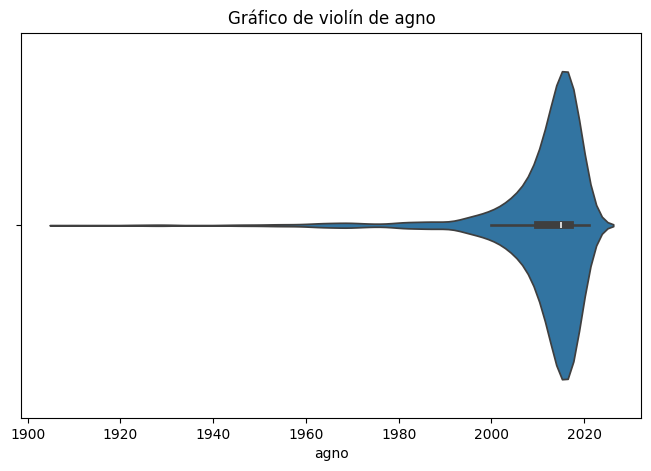

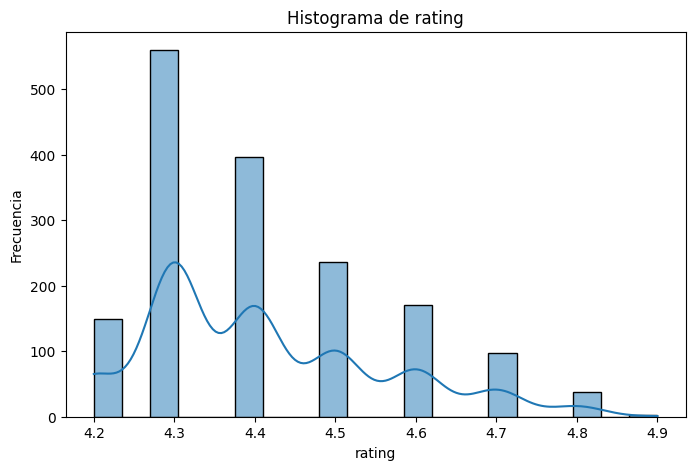

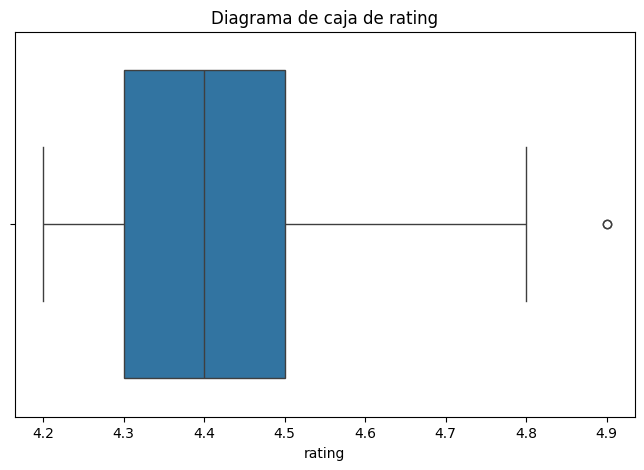

...

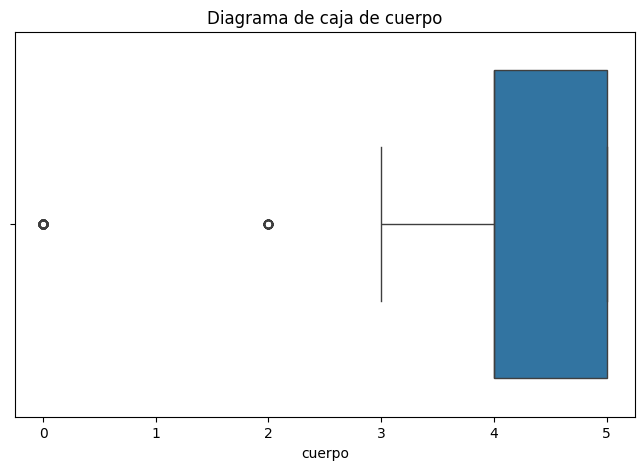

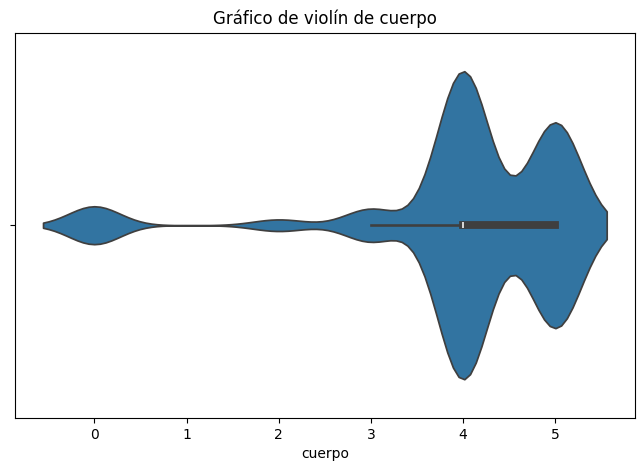

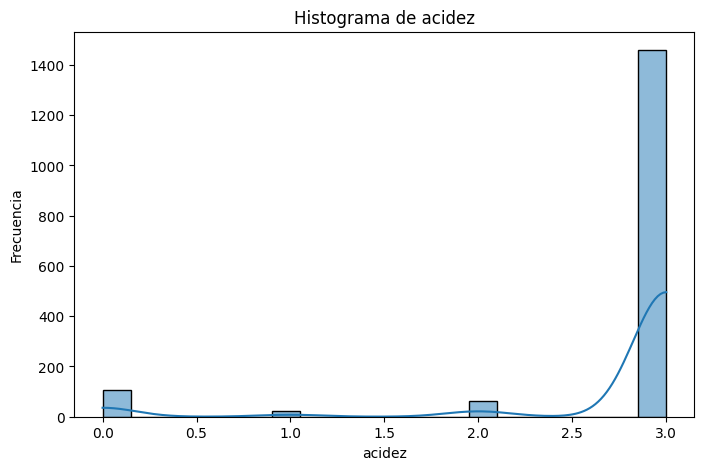

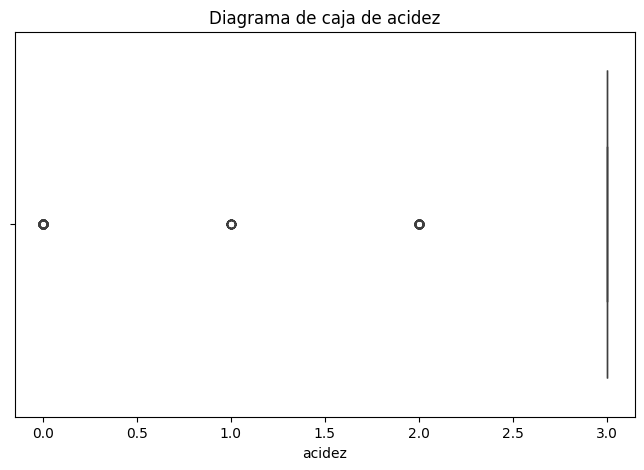

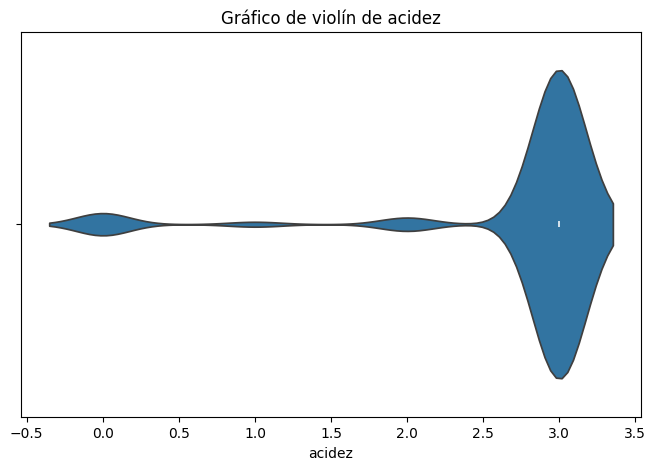

In [74]:
numeric_columns = wines.select_dtypes(include=['float64', 'int64']).columns

# Generar histogramas, diagramas de caja y gráficos de violín
for column in numeric_columns:
    # Histograma
    plt.figure(figsize=(8, 5))
    sns.histplot(wines[column], bins=20, kde=True)
    plt.title(f'Histograma de {column}')
    plt.xlabel(column)
    plt.ylabel('Frecuencia')
    plt.show()

    # Diagrama de caja
    plt.figure(figsize=(8, 5))
    sns.boxplot(x=wines[column])
    plt.title(f'Diagrama de caja de {column}')
    plt.xlabel(column)
    plt.show()

    # Gráfico de violín
    plt.figure(figsize=(8, 5))
    sns.violinplot(x=wines[column])
    plt.title(f'Gráfico de violín de {column}')
    plt.xlabel(column)
    plt.show()

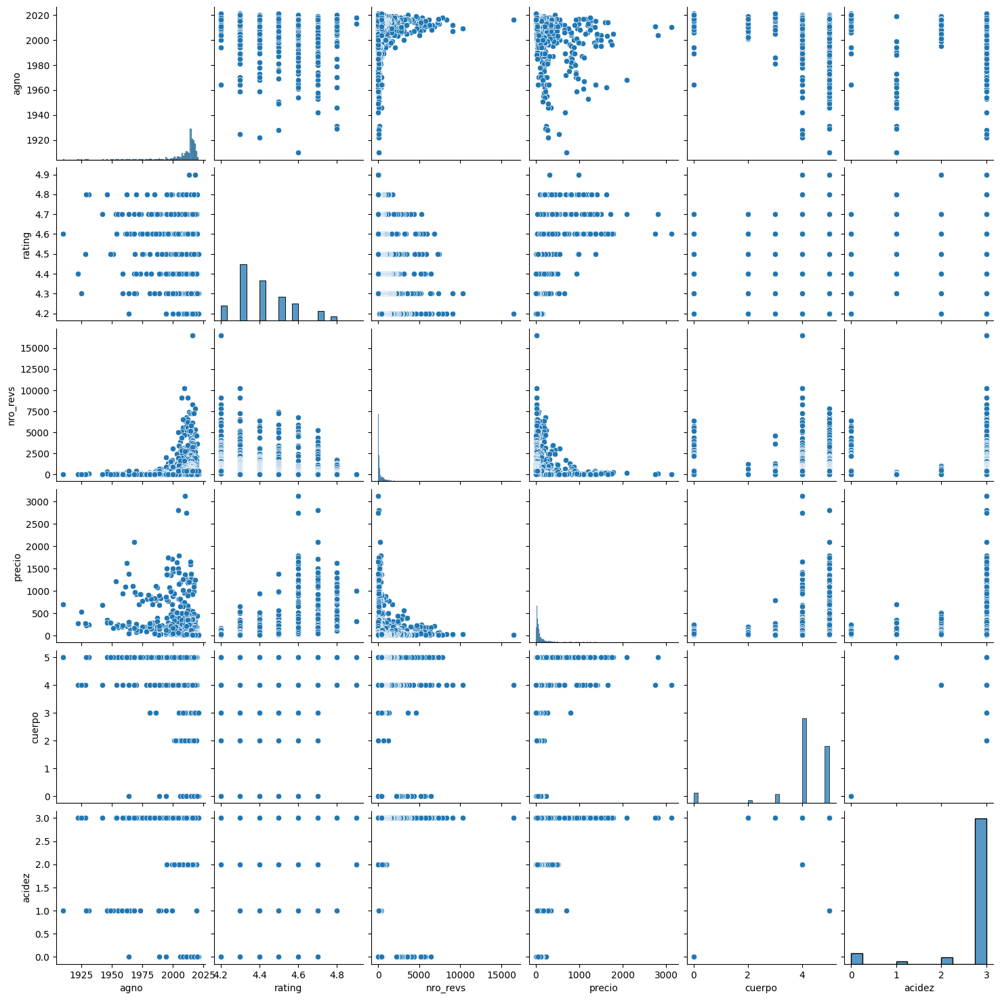

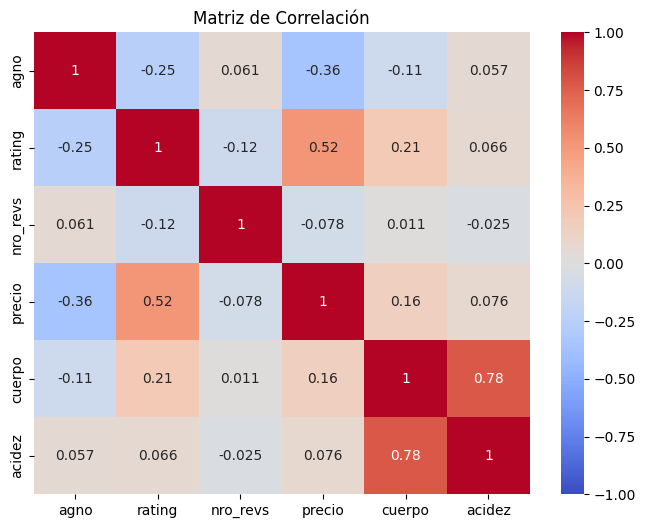

In [75]:
sns.pairplot(wines[['agno','rating','nro_revs','precio','cuerpo','acidez']])
plt.show()

# Gráfico de correlación
correlation_matrix = wines[['agno','rating','nro_revs','precio','cuerpo','acidez']].corr()
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Matriz de Correlación')
plt.show()

## Análisis de variables

Target Precio

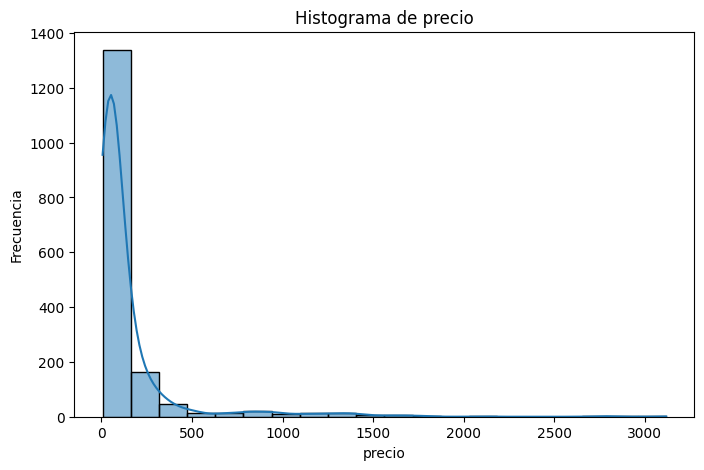

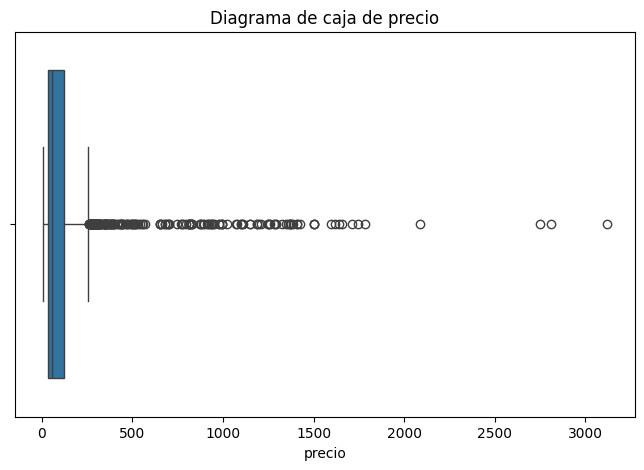

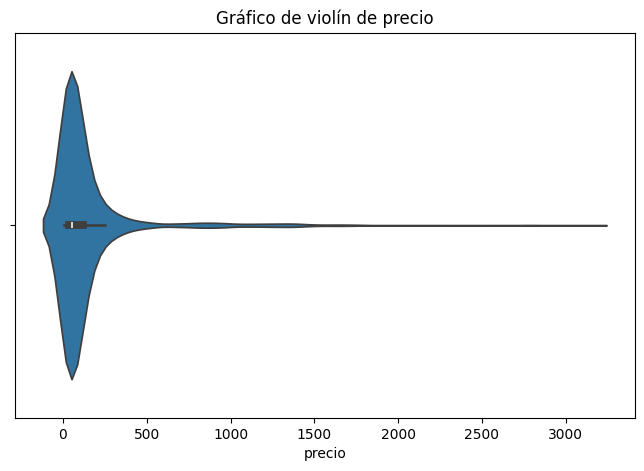

In [78]:
plt.figure(figsize=(8, 5))
sns.histplot(wines['precio'], bins=20, kde=True)
plt.title(f'Histograma de precio')
plt.xlabel('precio')
plt.ylabel('Frecuencia')
plt.show()

# Diagrama de caja
plt.figure(figsize=(8, 5))
sns.boxplot(x=wines['precio'])
plt.title(f'Diagrama de caja de precio')
plt.xlabel('precio')
plt.show()

# Gráfico de violín
plt.figure(figsize=(8, 5))
sns.violinplot(x=wines['precio'])
plt.title(f'Gráfico de violín de precio')
plt.xlabel('precio')
plt.show()

Target Tipo

In [ ]:
frecuencia = wines['tipo'].value_counts()

# Crea un DataFrame con los nombres y las frecuencias
df_frecuencia = pd.DataFrame({'Tipo': frecuencia.index, 'Frecuencia': frecuencia.values})

# Ajusta el tamaño del gráfico
altura_grafico = max(10, len(df_frecuencia) * 0.5)  # Ajusta según el número de tipos

# Crea el gráfico de barras
fig = go.Figure()
fig.add_trace(go.Bar(x=df_frecuencia['Tipo'], y=df_frecuencia['Frecuencia'], text=df_frecuencia['Frecuencia']))

# Añade scroll bar
fig.update_xaxes(tickangle=45, tickmode='linear', tick0=0, dtick=1)

# Ajusta el tamaño del gráfico
fig.update_layout(title_text='Frecuencia de Tipos de Vino', height=altura_grafico * 50)

# Muestra el gráfico en el notebook
fig.show()

Tablas de contingencia

In [82]:

contingency_vignedo_vino = pd.crosstab(wines['vignedo'], wines['vino'])
contingency_vignedo_vino_filtered = contingency_vignedo_vino.loc[(contingency_vignedo_vino != 0).any(axis=1), (contingency_vignedo_vino != 0).any(axis=0)]
print("Tabla de Contingencia para 'vignedo' y 'vino' (sin valores 0):")
print(contingency_vignedo_vino_filtered)
print()

contingency_pais_region = pd.crosstab(wines['pais'], wines['region'])
contingency_pais_region_filtered = contingency_pais_region.loc[(contingency_pais_region != 0).any(axis=1), (contingency_pais_region != 0).any(axis=0)]
print("Tabla de Contingencia para 'pais' y 'region' (sin valores 0):")
print(contingency_pais_region_filtered)
print()

contingency_region_tipo = pd.crosstab(wines['region'], wines['tipo'])
contingency_region_tipo_filtered = contingency_region_tipo.loc[(contingency_region_tipo != 0).any(axis=1), (contingency_region_tipo != 0).any(axis=0)]
print("Tabla de Contingencia para 'region' y 'tipo' (sin valores 0):")
print(contingency_region_tipo_filtered)


Tabla de Contingencia para 'vignedo' y 'vino' (sin valores 0):
vino                                              1194  17  \
vignedo                                                      
A Coroa                                              0   0   
AGE                                                  0   0   
Aalto                                                0   0   
Abadal                                               0   0   
Abadia Retuerta                                      0   0   
Abel Mendoza Monge                                   0   0   
Acustic Celler                                       0   0   
Adama Wines                                          0   0   
Agusti Torello Mata                                  0   0   
Albamar                                              0   0   
Albet i Noya                                         0   0   
Algueira                                             0   0   
Alion                                                0   0   
Allende

Prueba de Chi-Cuadrado

In [83]:
chi2_vignedo_vino, p_vignedo_vino, _, _ = chi2_contingency(contingency_vignedo_vino_filtered)
print(f"Prueba de Chi-Cuadrado para 'vignedo' y 'vino':")
print(f"Estadístico Chi-Cuadrado: {chi2_vignedo_vino}")
print(f"Valor p: {p_vignedo_vino}")
print()

# Realizar prueba de chi-cuadrado para 'pais' y 'region'
chi2_pais_region, p_pais_region, _, _ = chi2_contingency(contingency_pais_region_filtered)
print(f"Prueba de Chi-Cuadrado para 'pais' y 'region':")
print(f"Estadístico Chi-Cuadrado: {chi2_pais_region}")
print(f"Valor p: {p_pais_region}")
print()

# Realizar prueba de chi-cuadrado para 'region' y 'tipo'
chi2_region_tipo, p_region_tipo, _, _ = chi2_contingency(contingency_region_tipo_filtered)
print(f"Prueba de Chi-Cuadrado para 'region' y 'tipo':")
print(f"Estadístico Chi-Cuadrado: {chi2_region_tipo}")
print(f"Valor p: {p_region_tipo}")

Prueba de Chi-Cuadrado para 'vignedo' y 'vino':
Estadístico Chi-Cuadrado: 604346.0367740195
Valor p: 0.0

Prueba de Chi-Cuadrado para 'pais' y 'region':
Estadístico Chi-Cuadrado: 0.0
Valor p: 1.0

Prueba de Chi-Cuadrado para 'region' y 'tipo':
Estadístico Chi-Cuadrado: 21044.5735434393
Valor p: 0.0


# Preprocesamiento de la información 3 Algoritmos como minimo en cada actividad

 
 # Imputación de datos


* Árboles de Decisión: Pueden utilizarse tanto para regresión como para clasificación. Sin embargo, tienden a ser más utilizados en problemas de clasificación1.
* SVM (Support Vector Machines): Aunque originalmente se diseñaron para la clasificación binaria, también pueden utilizarse para la regresión (SVR) y la clasificación multiclase2.
* Regresión Logística: A pesar de su nombre, es un algoritmo de clasificación y se utiliza principalmente para problemas de clasificación binaria3.
* Random Forest: Es un algoritmo versátil que puede utilizarse tanto para tareas de regresión como de clasificación4.
* AdaBoost: Se utiliza principalmente para problemas de clasificación, pero también puede adaptarse para su uso en regresión5.
* Gradient Boosting Machine (GBM): Al igual que Random Forest y AdaBoost, GBM puede utilizarse tanto para regresión como para clasificación6.
* XGBoost: Es una implementación optimizada del algoritmo Gradient Boosting que puede utilizarse para problemas de regresión y clasificación7.
* LightGBM: Es un marco de boosting que también puede utilizarse para problemas de regresión y clasificación7.
Es importante tener en cuenta que el rendimiento de estos algoritmos puede variar dependiendo de la naturaleza de los datos y del problema específico que se esté abordando. Por lo tanto, es una buena práctica probar varios algoritmos y ajustar sus parámetros para encontrar el modelo que mejor se adapte a tus necesidades.

# Ingenieria y selección de caracteristicas. 

# Optimización de Hiperparametros